<a href="https://colab.research.google.com/github/hmobley/satellite-water/blob/main/Satellite_Project_Step1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
base_dir = '/content/drive/MyDrive/satellite'

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!ls /content/drive/MyDrive/satellite

Buscombe_liveProject_Feb2020


In [4]:
import os

In [5]:
project_dir = 'Buscombe_liveProject_Feb2020'
step1_proj_dir = os.path.join(base_dir,project_dir,'1_GettingStarted')
step2_proj_dir = os.path.join(base_dir,project_dir,'2_Data')
step3_proj_dir = os.path.join(base_dir,project_dir,'3_Models')
step4_proj_dir = os.path.join(base_dir,project_dir,'4_Training')
step5_proj_dir = os.path.join(base_dir,project_dir,'5_Optimizing')

In [6]:
!ls $step1_proj_dir

conda_env			 Part_1_GettingStarted.ipynb
liveProject_Buscombe_Part1.docx  requirements.txt


In [7]:
requirements = os.path.join(step1_proj_dir,'requirements.txt')

In [8]:
!python -m pip install --user -r $requirements

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 48 kB 5.6 MB/s 
     |████████████████████████████████| 121 kB 67.2 MB/s 
     |████████████████████████████████| 8.1 MB 39.6 MB/s 
     |████████████████████████████████| 74 kB 3.2 MB/s 
     |████████████████████████████████| 1.6 MB 64.1 MB/s 
     |████████████████████████████████| 83 kB 2.4 MB/s 
  Created wheel for Image: filename=image-1.5.33-py2.py3-none-any.whl size=19494 sha256=93b9e143d2b10b14f1bd7d77a2aa3486f17a13bbb593cee8ecdb2e398f2b9986
  Stored in directory: /root/.cache/pip/wheels/ac/30/5c/a8b33888bea3507eda7c924a143d34b2390d2ca5b145b327b5
Successfully built Image
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH o

In [9]:
import tensorflow as tf
tf.__version__

'2.9.2'

In [10]:
#tf.test.is_gpu_available()
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [11]:
# Tensorflow keras layers
#from tensorflow.python.keras.layers import Dense, Flatten, Dropout, BatchNormalization
from tensorflow.keras.layers import Dense, Flatten, Dropout, BatchNormalization

In [12]:
model = tf.keras.models.Sequential()
model.add(Flatten(input_shape=(28,28)))
model.add(Dense(units=128, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(units=10, activation='softmax'))

In [13]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 784)               0         
                                                                 
 dense (Dense)               (None, 128)               100480    
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_1 (Dense)             (None, 10)                1290      
                                                                 
Total params: 101,770
Trainable params: 101,770
Non-trainable params: 0
_________________________________________________________________


In [14]:
model = tf.keras.models.Sequential([
  tf.keras.layers.Flatten(input_shape=(28, 28)),
  tf.keras.layers.Dense(128, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(10, activation='softmax')
])

In [15]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_1 (Flatten)         (None, 784)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               100480    
                                                                 
 dropout_1 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)             (None, 10)                1290      
                                                                 
Total params: 101,770
Trainable params: 101,770
Non-trainable params: 0
_________________________________________________________________


In [16]:
mnist = tf.keras.datasets.mnist

(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0

11490434/11490434 [==============================] - 2s 0us/step


In [17]:
import numpy as np

# check some statistics
IMAGE_HEIGHT, IMAGE_WIDTH = x_train.shape[1:3]
print("# of train examples:", x_train.shape[0])
print("# of test examples:", x_test.shape[0])
print("Image shape:", x_train[0].shape)
print("Pixel value interval:", np.min(x_train), np.max(x_train))
print("Train shape:",x_train.shape)
print("Test shape:",x_test.shape)
print("Image height:",IMAGE_HEIGHT)
print("Image width:",IMAGE_WIDTH)

# of train examples: 60000
# of test examples: 10000
Image shape: (28, 28)
Pixel value interval: 0.0 1.0
Train shape: (60000, 28, 28)
Test shape: (10000, 28, 28)
Image height: 28
Image width: 28


In [18]:
import matplotlib.pyplot as plt

In [19]:
from tensorflow.python.keras.callbacks import TensorBoard

In [20]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
%reload_ext tensorboard

# create the tensorboard callback
tensorboard = TensorBoard(log_dir='logs', histogram_freq=1)

In [21]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [22]:
model.fit(x_train, y_train, epochs=5, callbacks=[tensorboard])

Epoch 1/5
1875/1875 [==============================] - 11s 4ms/step - loss: 0.2943 - accuracy: 0.9151
Epoch 2/5
1875/1875 [==============================] - 4s 2ms/step - loss: 0.1425 - accuracy: 0.9579
Epoch 3/5
1875/1875 [==============================] - 4s 2ms/step - loss: 0.1067 - accuracy: 0.9671
Epoch 4/5
1875/1875 [==============================] - 4s 2ms/step - loss: 0.0864 - accuracy: 0.9727
Epoch 5/5
1875/1875 [==============================] - 4s 2ms/step - loss: 0.0735 - accuracy: 0.9772


In [23]:
# launch TensorBoard from Jupyter
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [24]:
model.evaluate(x_test, y_test, verbose=0)

[0.07303749024868011, 0.9782000184059143]

In [25]:
from sklearn.metrics import confusion_matrix

In [26]:
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    fig, ax = plt.subplots(figsize=(8,8))
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')
    
    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

In [27]:
# Test your model using the test data
predictions = model.predict(x_test)
predictions = tf.argmax(predictions, axis=1)

313/313 [==============================] - 1s 2ms/step


Confusion matrix, without normalization


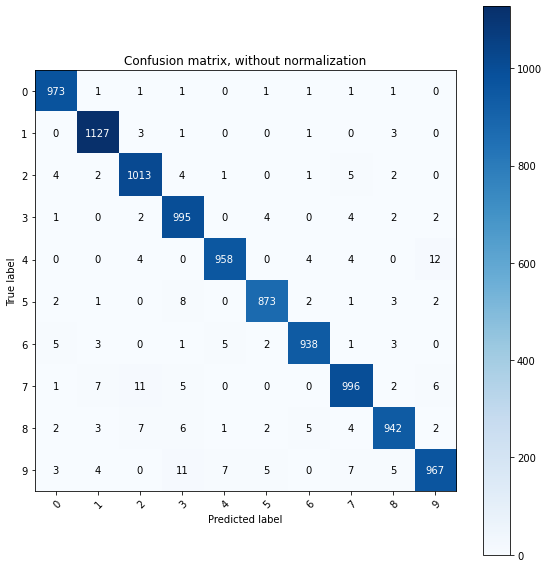

In [28]:
# check the confusion matrix
classes=['0','1','2','3','4','5','6','7','8','9']

plot_confusion_matrix(y_test, predictions, classes)

In [29]:
!cat $requirements

numpy
scipy
jupyter
matplotlib
sentinelsat
Image
scikit-image
scikit-learn


In [30]:
pip install rasterio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 20.9 MB 6.4 MB/s 


In [31]:
import rasterio
import glob
import os

In [32]:
# from https://stackoverflow.com/questions/38511444/python-download-files-from-google-drive-using-url
import requests

def download_file_from_google_drive(id, destination):
    URL = "https://docs.google.com/uc?export=download"

    session = requests.Session()

    response = session.get(URL, params = { 'id' : id }, stream = True)
    token = get_confirm_token(response)

    if token:
        params = { 'id' : id, 'confirm' : token }
        response = session.get(URL, params = params, stream = True)

    save_response_content(response, destination)    

def get_confirm_token(response):
    for key, value in response.cookies.items():
        if key.startswith('download_warning'):
            return value

    return None

def save_response_content(response, destination):
    CHUNK_SIZE = 32768

    with open(destination, "wb") as f:
        for chunk in response.iter_content(CHUNK_SIZE):
            if chunk: # filter out keep-alive new chunks
                f.write(chunk)

In [42]:
#file_id = '1o76QoBtn6ExxO8KgcCqdOiun_KsWoMJl'
#file_id = '1iJf6vmHqfF0vNDaG5ubiQx5GoXXwOcRz'
file_id = '1CknbyhS57a8HF0WDONW0icsjw5arDKzc'
#destination = 'example_TCI_10m.jp2'
#destination = "experiment.jp2"
destination = "experiment-2.jp2"
download_file_from_google_drive(file_id, destination)

In [34]:
#https://drive.google.com/file/d/1iJf6vmHqfF0vNDaG5ubiQx5GoXXwOcRz/view?usp=sharing
#https://drive.google.com/file/d/1CknbyhS57a8HF0WDONW0icsjw5arDKzc/view?usp=sharing

#!pip install -q condacolab
#import condacolab
#condacolab.install()

In [35]:
#!mamba install -q gdal=3.6.1

In [36]:
#from osgeo import gdal
#gdal.VersionInfo()

In [37]:
#!pip gdal --upgrade
#!apt update
#!apt upgrade
#!apt install gdal-bin python-gdal python3-gdal

In [38]:
!gdalinfo --version
!python --version
#%%shell
#wget -c https://repo.anaconda.com/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
#chmod +x Miniconda3-4.5.4-Linux-x86_64.sh
#bash ./Miniconda3-4.5.4-Linux-x86_64.sh -b -f -p /usr/local
#conda install -q -y --prefix /usr/local python=3.8 gdal

GDAL 2.2.3, released 2017/11/20
Python 3.8.16


In [39]:
import gdal
driver_list = []
for i in range(gdal.GetDriverCount()):
    driver = gdal.GetDriver(i)
    driver_list.append(driver.GetDescription())

# list comprehension
driver_list = [gdal.GetDriver(i).GetDescription() for i in range(gdal.GetDriverCount())]
#display([x for x in driver_list if x=='JP2ECW'])
display([x for x in driver_list if x=='JP2OpenJPEG'])
display(driver_list)

['JP2OpenJPEG']

['VRT',
 'DERIVED',
 'GTiff',
 'NITF',
 'RPFTOC',
 'ECRGTOC',
 'HFA',
 'SAR_CEOS',
 'CEOS',
 'JAXAPALSAR',
 'GFF',
 'ELAS',
 'AIG',
 'AAIGrid',
 'GRASSASCIIGrid',
 'SDTS',
 'OGDI',
 'DTED',
 'PNG',
 'JPEG',
 'MEM',
 'JDEM',
 'GIF',
 'BIGGIF',
 'ESAT',
 'BSB',
 'XPM',
 'BMP',
 'DIMAP',
 'AirSAR',
 'RS2',
 'SAFE',
 'PCIDSK',
 'PCRaster',
 'ILWIS',
 'SGI',
 'SRTMHGT',
 'Leveller',
 'Terragen',
 'GMT',
 'netCDF',
 'HDF4',
 'HDF4Image',
 'ISIS3',
 'ISIS2',
 'PDS',
 'VICAR',
 'TIL',
 'ERS',
 'JP2OpenJPEG',
 'L1B',
 'FIT',
 'GRIB',
 'RMF',
 'WCS',
 'WMS',
 'MSGN',
 'RST',
 'INGR',
 'GSAG',
 'GSBG',
 'GS7BG',
 'COSAR',
 'TSX',
 'COASP',
 'R',
 'MAP',
 'KMLSUPEROVERLAY',
 'WEBP',
 'PDF',
 'Rasterlite',
 'MBTiles',
 'PLMOSAIC',
 'CALS',
 'WMTS',
 'SENTINEL2',
 'MRF',
 'PNM',
 'DOQ1',
 'DOQ2',
 'GenBin',
 'PAux',
 'MFF',
 'MFF2',
 'FujiBAS',
 'GSC',
 'FAST',
 'BT',
 'LAN',
 'CPG',
 'IDA',
 'NDF',
 'EIR',
 'DIPEx',
 'LCP',
 'GTX',
 'LOSLAS',
 'NTv2',
 'CTable2',
 'ACE2',
 'SNODAS',
 'KRO',
 'ROI_P

In [43]:
#with rasterio.open('example_TCI_10m.jp2', driver='JP2OpenJPEG') as dataset:
with rasterio.open(destination, driver='JP2OpenJPEG') as dataset:
    array = dataset.read(1)
    print(dataset.profile)

/usr/local/lib/python3.8/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


{'driver': 'JP2OpenJPEG', 'dtype': 'uint8', 'nodata': None, 'width': 2717, 'height': 3701, 'count': 3, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'blockxsize': 1024, 'blockysize': 1024, 'tiled': True, 'interleave': 'pixel'}


In [51]:
def write_image(input, output, band):
    with rasterio.open(input) as src_dataset:
        #with rasterio.open('example_TCI_10m.jp2', driver='JP2OpenJPEG') as dataset:
        with rasterio.open(input, driver='JP2OpenJPEG') as dataset:
            array = dataset.read(band)
        # Get a copy of the source dataset's profile. Thus our
        # destination dataset will have the same dimensions,
        # number of bands, data type, and georeferencing as the
        # source dataset.
        kwds = src_dataset.profile

        # Change the format driver for the destination dataset to
        # 'GTiff', short for GeoTIFF.
        kwds['driver'] = 'GTiff'

        # Add GeoTIFF-specific keyword arguments.
        kwds['tiled'] = True
        kwds['blockxsize'] = 256
        kwds['blockysize'] = 256
        kwds['photometric'] = 'YCbCr'
        kwds['compress'] = 'JPEG'

        with rasterio.open(output, 'w', **kwds) as dst_dataset:
            # Write data to the destination dataset.
            #dst_dataset.write(array.astype(rasterio.uint8), 1)
            dst_dataset.write(array.astype(rasterio.uint8), band)

In [45]:
file_list = ['r1.tif', 'r2.tif', 'r3.tif']

In [53]:
#[write_image('example_TCI_10m.jp2',f, band) for f,band in zip(file_list, [1,2,3])]
[write_image(destination,f, band) for f,band in zip(file_list, [1,2,3])]

[None, None, None]

In [56]:
# Read metadata of first file
with rasterio.open(file_list[0]) as src0:
    meta = src0.meta

# Update meta to reflect the number of layers
meta.update(count = len(file_list))

# Read each layer and write it to stack
with rasterio.open('stack.tif', 'w', **meta) as dst:
    for id, layer in enumerate(file_list, start=1):
        #print(F'id:{id}, layer:{layer}')
        with rasterio.open(layer) as src1:
            dst.write_band(id, src1.read(id))
            #dst.write_band(id, src1.read(1))

/usr/local/lib/python3.8/dist-packages/rasterio/__init__.py:314: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising an error. This behavior is somewhat driver-specific.
  dataset = writer(


In [58]:
from rasterio.warp import calculate_default_transform, reproject, Resampling

dst_crs = 'EPSG:4326'

# note there is a nested 'with statement' here
# the first 'with' command opens the image as src
with rasterio.open('stack.tif') as src:
    transform, width, height = calculate_default_transform(
        src.crs, dst_crs, src.width, src.height, *src.bounds)
    kwargs = src.meta.copy()
    kwargs.update({
        'crs': dst_crs,
        'transform': transform,
        'width': width,
        'height': height
    })
# the second 'with' statement opens an image for writing
    with rasterio.open('reprojected_stack.tif', 'w', **kwargs) as dst:
        for i in range(1, src.count + 1):
            reproject(
                source=rasterio.band(src, i),
                destination=rasterio.band(dst, i),
                src_transform=src.transform,
                src_crs=src.crs,
                dst_transform=transform,
                dst_crs=dst_crs,
                resampling=Resampling.nearest)

In [60]:
# deliverable
#from kera.preprocessing.image
#from keras.preprocessing.image import load_img
import PIL
import PIL.Image

# img = np.load_image
# tf.image.adjust_gamma()
# tf.image.adjust_gamma(
#     image, gamma=1, gain=1
# )


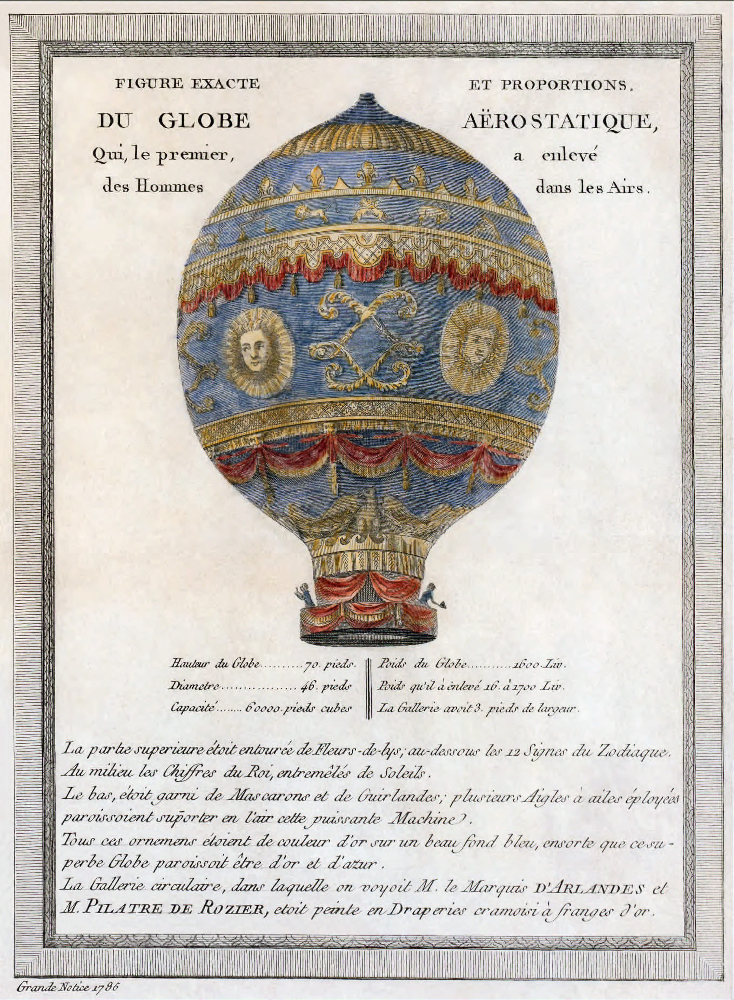

In [61]:
PIL.Image.open('stack.tif')

In [65]:
with PIL.Image.open("stack.tif") as im:
    #im.rotate(45).show()
    x = np.array(im)
    x = tf.image.adjust_gamma(x, 0.2)
    display(x)

<tf.Tensor: shape=(3701, 2717, 3), dtype=uint8, numpy=
array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [167, 133, 151],
        [175, 144, 171],
        [127,   0, 138]],

       [[182, 165, 186],
        [182, 165, 186],
        [182, 165, 186],
        ...,
        [201, 176, 204],
        [205, 185, 208],
        [185, 180, 191]],

       [[242, 244, 237],
        [242, 244, 237],
        [242, 244, 237],
        ...,
        [244, 243, 236],
        [243, 243, 235],
        [226, 235, 221]],

       ...,

       [[253, 251, 253],
        [253, 251, 253],
        [253, 251, 253],
        ...,
        [251, 250, 253],
        [247, 246, 248],
        [238, 241, 232]],

       [[254, 249, 252],
        [254, 248, 252],
        [254, 248, 252],
        ...,
        [249, 247, 250],
        [247, 242, 246],
        [238, 239, 233]],

       [[242, 245, 235],
        [242, 245, 235],
        [242, 245, 235],
        ...,
        [241, 243, 